In [1]:
import sys
sys.path.append(r'/hr-fs02/hr_projekte/Pol-InSAR_InfoRetrieval/10_users/mans_is/PyPolSAR')

In [2]:
import rioxarray
import rasterio as rio
import pandas as pd
import numpy as np
import xarray as xr
import geopandas as gpd
from shapely.geometry import box, mapping
from scipy import ndimage
from pypolsar import geo
import pprint
import warnings
warnings.filterwarnings("ignore")


In [3]:
import h5py

from pypolsar import polsar
import matplotlib.pyplot as plt

from pypolsar import utils, plot
from pypolsar import polsar
from pypolsar.polsar import decomposition

from pypolsar.stats.timer import Timer
from pathlib import Path
import pypolsar

import seaborn as sns
from matplotlib.colors import LogNorm
from matplotlib.ticker import PercentFormatter
import numpy as np
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap


In [4]:
from pathlib import Path

process = Path('./processed/')
process = Path('./../data/processed/')

# p = Path('./')
# p = Path("./processed/dem-convert/") # demgeo_18prmasr0302.tif
prj = Path('./../data/01_projects/')

def dict_project_files(process_path, prj_path):
    prj_data_paths = {}
    prj_data_paths["18"] = {}
    prj_data_paths["18"]["polarimetric"]  = sorted(list( process_path.glob('./polarimetric/18*_entropy.tif')))
    prj_data_paths["18"]["dem_2m_2m"]     = sorted(list( process_path.glob('./DEM/2mx2m/demgeo_18*.tif')))
    prj_data_paths["18"]["incidence_geo"] = sorted(list( prj_path.glob('./18PRMASR/**/FL03/**/T*[!X]/**/GTC-IMG/incidencegeo*.rat')))
    prj_data_paths["18"]["masks_geo"]     = sorted(list( prj_path.glob('./18PRMASR/**/FL03/**/T*[!X]/**/GTC-IMG/maskgeo*.rat')))
    prj_data_paths["18"]["offnadir_geo"]  = sorted(list( prj_path.glob('./18PRMASR/**/FL03/**/T*[!X]/**/GTC-IMG/offnadirgeo*.rat')))
    prj_data_paths["18"]["pauli_geo"]  = sorted(list( prj_path.glob('./18PRMASR/**/FL03/**/T*[!X]/**/GTC-IMG/pauli*.rat')))

    prj_data_paths["19"] = {}
    prj_data_paths["19"]["polarimetric"]  = sorted(list( process_path.glob('./polarimetric/19*_entropy.tif')))
    prj_data_paths["19"]["dem_2m_2m"]     = sorted(list( process_path.glob('./DEM/2mx2m/demgeo_19*.tif')))
    prj_data_paths["19"]["incidence_geo"] = sorted(list( prj.glob('./19PRMASR/**/FL10/**/T*[!X]/**/GTC-IMG/incidencegeo*.rat')))
    prj_data_paths["19"]["masks_geo"]     = sorted(list( prj.glob('./19PRMASR/**/FL10/**/T*[!X]/**/GTC-IMG/maskgeo*.rat')))
    prj_data_paths["19"]["offnadir_geo"]  = sorted(list( prj.glob('./19PRMASR/**/FL10/**/T*[!X]/**/GTC-IMG/offnadirgeo*.rat')))
    prj_data_paths["19"]["pauli_geo"] = sorted(list( prj.glob('./19PRMASR/**/FL10/**/T*[!X]/**/GTC-IMG/pauli*.rat')))
    
    return prj_data_paths
    

prj_data_paths = dict_project_files(process_path=process, prj_path=prj)
prj_data_paths

{'18': {'polarimetric': [PosixPath('../data/processed/polarimetric/18prmasr0302_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0302_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0303_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0303_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0304_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0304_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0305_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0305_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0306_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0306_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0307_L_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0307_S_entropy.tif'),
   PosixPath('../data/processed/polarimetric/18prmasr0308_L_entropy.tif'),
   

In [5]:
prj_paths = {}
processed_path = "./processed/"
processed_path = process

processed_path = Path(processed_path)
for prj_year in list(prj_data_paths):
    prj_paths[prj_year] = {}
    prj_data_paths[prj_year]["masks_geo"] 
    for idx in range(len(prj_data_paths[prj_year]["masks_geo"])):
        tile_title = prj_data_paths[prj_year]["masks_geo"][idx].name[5+3:19+3]
        prj_paths[prj_year][tile_title] = {}
        prj_paths[prj_year][tile_title]["geo"] = {}
        prj_paths[prj_year][tile_title]["geo"]["incidence"] = prj_data_paths[prj_year]["incidence_geo"][idx]
        prj_paths[prj_year][tile_title]["geo"]["mask"] = prj_data_paths[prj_year]["masks_geo"][idx]
        prj_paths[prj_year][tile_title]["geo"]["offnadir"] = prj_data_paths[prj_year]["offnadir_geo"][idx]
        prj_paths[prj_year][tile_title]["geo"]["pauli"] = prj_data_paths[prj_year]["pauli_geo"][idx]
        prj_paths[prj_year][tile_title]["pol"] = {}
        prj_paths[prj_year][tile_title]["pol"]["entropy"]      = Path.joinpath(prj_data_paths[prj_year]["polarimetric"][idx].parent, tile_title + "_entropy.tif")
        prj_paths[prj_year][tile_title]["pol"]["anisotropy"]   = Path.joinpath(prj_data_paths[prj_year]["polarimetric"][idx].parent, tile_title + "_anisotropy.tif")
        prj_paths[prj_year][tile_title]["pol"]["alpha"]        = Path.joinpath(prj_data_paths[prj_year]["polarimetric"][idx].parent, tile_title + "_alpha.tif")
        prj_paths[prj_year][tile_title]["pol"]["p_hhvv"]       = Path.joinpath(prj_data_paths[prj_year]["polarimetric"][idx].parent, tile_title + "_p_hhvv.tif")
        prj_paths[prj_year][tile_title]["pol"]["ph_diff_hhvv"] = Path.joinpath(prj_data_paths[prj_year]["polarimetric"][idx].parent, tile_title + "_ph_diff_hhvv.tif")

        for item in list(prj_paths[prj_year][tile_title]):
            #print(item)
            for key_path in list(prj_paths[prj_year][tile_title][item]):

                """            
                print(key_path)
                print(prj_paths[tile_title][item][key_path])
                """
                #print(key_path)
                try:
                    my_abs_path = prj_paths[prj_year][tile_title][item][key_path].resolve(strict=True)
                except FileNotFoundError:
                    # doesn't exist
                    print(FileNotFoundError, prj_paths[tile_title][item][key_path])
                #else:
                    # exists
                #    print("Files exist:", my_abs_path)


pprint.pprint(prj_paths)

{'18': {'18prmasr0302_L': {'geo': {'incidence': PosixPath('../data/01_projects/18PRMASR/FL03/PS02/T01L/GTC/GTC-IMG/incidencegeo_18prmasr0302_L_t01L.rat'),
                                   'mask': PosixPath('../data/01_projects/18PRMASR/FL03/PS02/T01L/GTC/GTC-IMG/maskgeo_18prmasr0302_L_t01L.rat'),
                                   'offnadir': PosixPath('../data/01_projects/18PRMASR/FL03/PS02/T01L/GTC/GTC-IMG/offnadirgeo_18prmasr0302_L_t01L.rat'),
                                   'pauli': PosixPath('../data/01_projects/18PRMASR/FL03/PS02/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0302_L_t01L.rat')},
                           'pol': {'alpha': PosixPath('../data/processed/polarimetric/18prmasr0302_L_alpha.tif'),
                                   'anisotropy': PosixPath('../data/processed/polarimetric/18prmasr0302_L_anisotropy.tif'),
                                   'entropy': PosixPath('../data/processed/polarimetric/18prmasr0302_L_entropy.tif'),
                                   'p_

# Pauli Image

In [6]:
fig_save = Path("./../figures/")

In [7]:
elements = []
pauli_18_L = []
pauli_18_S = []

import rioxarray
from rioxarray import merge
from rasterio.plot import show

for item in prj_data_paths["18"]["pauli_geo"]:
    rds = rioxarray.open_rasterio(item)
    rds.data[rds.data == 0.0] = np.nan    
    if "L.rat" in str(item):
        print(item)
        pauli_18_L.append(rds)
    if "S.rat" in str(item):
        print(item)
        pauli_18_S.append(rds)
    
pauli_19_L = []

pauli_19_S = []

for item in prj_data_paths["19"]["pauli_geo"]:
    rds = rioxarray.open_rasterio(item)
    rds.data[rds.data == 0.0] = np.nan   
    if "L.rat" in str(item):
        print(item)
        pauli_19_L.append(rds)
    if "S.rat" in str(item):
        print(item)
        pauli_19_S.append(rds)
    

../data/01_projects/18PRMASR/FL03/PS02/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0302_L_t01L.rat
../data/01_projects/18PRMASR/FL03/PS02/T01S/GTC/GTC-IMG/pauligeo_pres_18prmasr0302_S_t01S.rat
../data/01_projects/18PRMASR/FL03/PS03/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0303_L_t01L.rat
../data/01_projects/18PRMASR/FL03/PS03/T01S/GTC/GTC-IMG/pauligeo_pres_18prmasr0303_S_t01S.rat
../data/01_projects/18PRMASR/FL03/PS04/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0304_L_t01L.rat
../data/01_projects/18PRMASR/FL03/PS04/T01S/GTC/GTC-IMG/pauligeo_pres_18prmasr0304_S_t01S.rat
../data/01_projects/18PRMASR/FL03/PS05/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0305_L_t01L.rat
../data/01_projects/18PRMASR/FL03/PS05/T01S/GTC/GTC-IMG/pauligeo_pres_18prmasr0305_S_t01S.rat
../data/01_projects/18PRMASR/FL03/PS06/T01L/GTC/GTC-IMG/pauligeo_pres_18prmasr0306_L_t01L.rat
../data/01_projects/18PRMASR/FL03/PS06/T01S/GTC/GTC-IMG/pauligeo_pres_18prmasr0306_S_t01S.rat
../data/01_projects/18PRMASR/FL03/PS07/T01L/GTC/GTC-IMG/paul

In [8]:
merged = merge.merge_arrays(pauli_18_L, nodata=np.nan, method="max")


In [10]:
merged

<xarray.DataArray (band: 4, y: 14495, x: 18761)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)
Coordinates:
  * x            (x) float64 5.675e+05 5.675e+05 ... 5.863e+05 5.863e+05
  * y            (y) float64 7.728e+06 7.728e+06 ... 7.713e+06 7.713e+06
  * band         (band) int64 1 2 3 4
    spatial_ref  int64 0
Attributes:
    scale_factor:         1.0
    add_offset:           0.0
    bands:                4
    byte_order:           0
    data_type:            4
    description:          Geocoded data /fsar_raid/18PRMASR/FL03/PS02/T01L/GT...
    file_type:            ENVI Standard
    georeferenced:        UTM
    header_offset:        1000
    interleave:           BIP
    lines:                9420
    max_easting:          572893.0381734846
    max_northing:         7725448.6809147662
    min_easting:          567539.0381734846
    min_northing:         7716029.6809147662
    pixel_spacing_east:   1.0000000000
    pixel_spacing_north:  1.0000000000
    projection_zone:      7
    samples:              5355
    sensor_type:          SAR
    spheroid_name:        WGS-84
    wavelength:           [0.22620758]
    grid_mapping:         spatial_ref
    _FillValue:           nan

In [23]:
merged.sel({"band": 2, 1, 3})

SyntaxError: invalid syntax (<ipython-input-23-77ac58a080e5>, line 1)

In [17]:
pauli_tiles = merged.drop(merged.band == 4)
# pauli_tiles.data = merged.data[:3,:,:]
pauli_tiles

TypeError: unhashable type: 'DataArray'

(-0.5, 18760.5, 14494.5, -0.5)

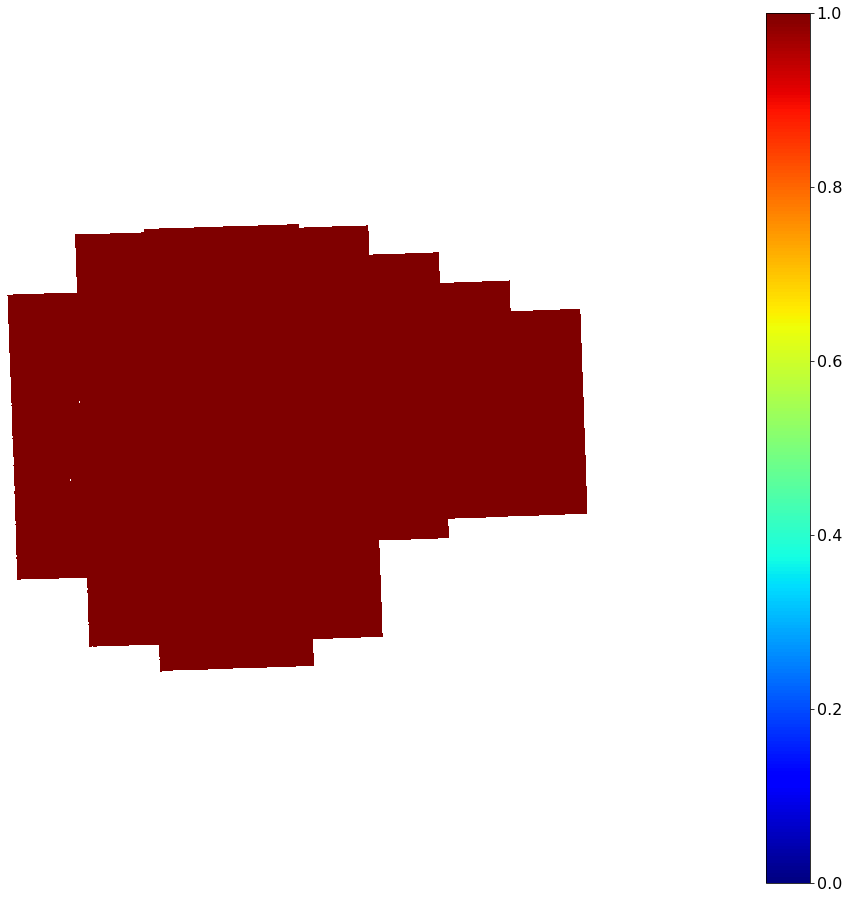

In [8]:
# merged = merge.merge_arrays(pauli_18_L, nodata=np.nan)  # , method="first")
plt.imshow(merged.data[0, :, :], vmin=0, vmax=1, cmap="jet", origin='upper', )
plt.colorbar(orientation="vertical", pad=0.2)
plt.axis('off')


In [8]:
def create_pauli(merged):
    pauli_vector = np.moveaxis([merged.data[0, :, :], merged.data[1, :, :], merged.data[2, :, :]], 0, -1)

    k_vec = np.abs(pauli_vector)
    # k_vec = np.ma.masked_where(k_vec == np.nan, k_vec)

    k_sca = k_vec ** 0.7
    vmin=2
    vmax=98
    im_perc = np.nanpercentile(k_sca, [vmin, vmax])
    k_sca = np.ma.masked_invalid(k_sca)

    """
    k_1 = plot.permasar.bytescale(k_sca[:, :, 0], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
    k_2 = plot.permasar.bytescale(k_sca[:, :, 1], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
    k_3 = plot.permasar.bytescale(k_sca[:, :, 2], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
    """
    k_1 = plot.permasar.bytescale(k_sca[:, :, 0], cmin=im_perc[0], cmax=im_perc[1])
    k_2 = plot.permasar.bytescale(k_sca[:, :, 1], cmin=im_perc[0], cmax=im_perc[1])
    k_3 = plot.permasar.bytescale(k_sca[:, :, 2], cmin=im_perc[0], cmax=im_perc[1])

    rgb = plot.permasar.np.stack((k_2, k_1, k_3), axis=2)/255
    rgb = np.ma.masked_where(np.isnan(k_vec), rgb, ) # fill_value=np.nan)
    # np.ma.masked_array(data=np.array([1.0,2.0]),mask=[True, False], fill_value=np.nan)  
    #alpha = ~np.all(rgb == 255, axis=2) * 255
    # alpha = (k_vec == np.nan)
    #rgba = np.dstack((rgb, alpha)).astype(np.uint8)
    return rgb # np.ma.set_fill_value(rgb, np.nan)


In [ ]:
np.isnan(k_vec)

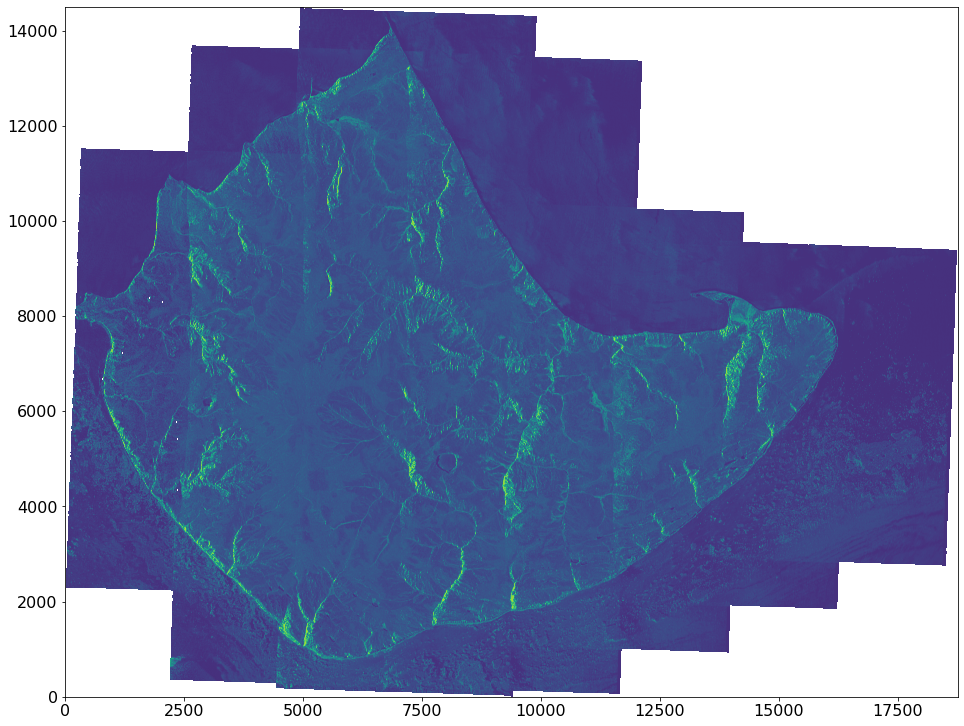

In [16]:
plt.imshow(merged.data[0,:,:])

In [ ]:
np.ma.masked_array(data=create_pauli(merged), mask=[k_vec == np.nan], fill_value=np.nan) 

In [13]:
pauli_rgb = create_pauli(merged)
pauli_rgb

masked_array(
  data=[[[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        ...,

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]]],
  mask=[[[ True,  True,  True],
         [ True,

In [ ]:
pauli_rgb.

(-0.5, 18760.5, 14494.5, -0.5)

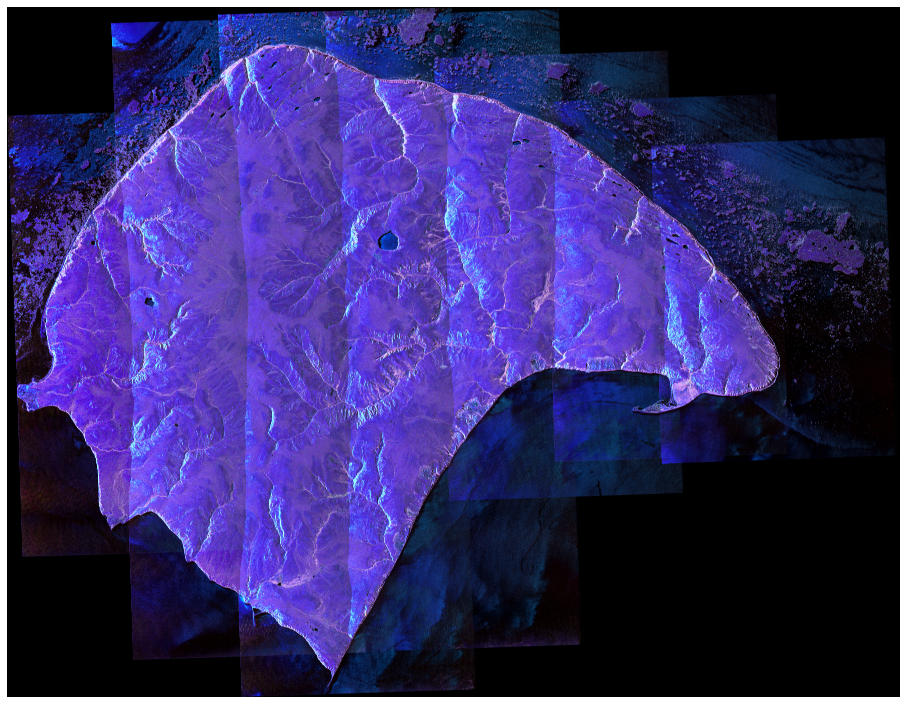

In [14]:


fig, ax = plt.subplots(1, 1)


ax.imshow(pauli_rgb,  origin='upper',)
ax.axis('off')

In [9]:
print("now")

now


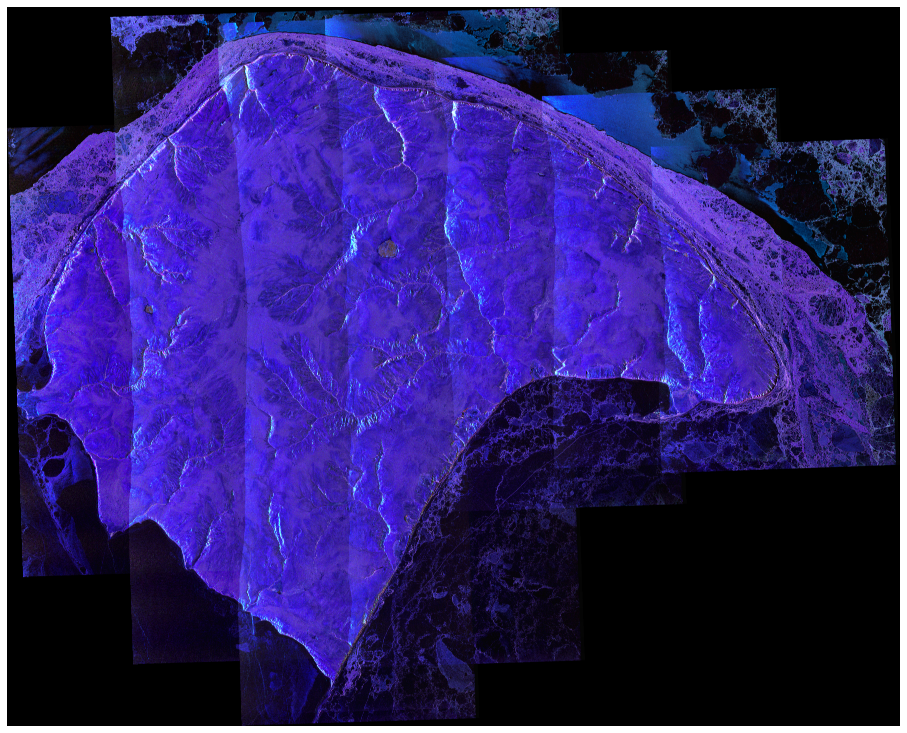

In [10]:
merged = merge.merge_arrays(pauli_19_L, nodata=np.nan, method="max")
pauli_rgb_19_L = create_pauli(merged)

fig, ax = plt.subplots(1, 1)


ax.imshow(pauli_rgb_19_L,  origin='upper',)
ax.axis('off')
fig.savefig(fig_save.joinpath("./PNG/maps/", "pauli_rgb_19_L" +".png"))

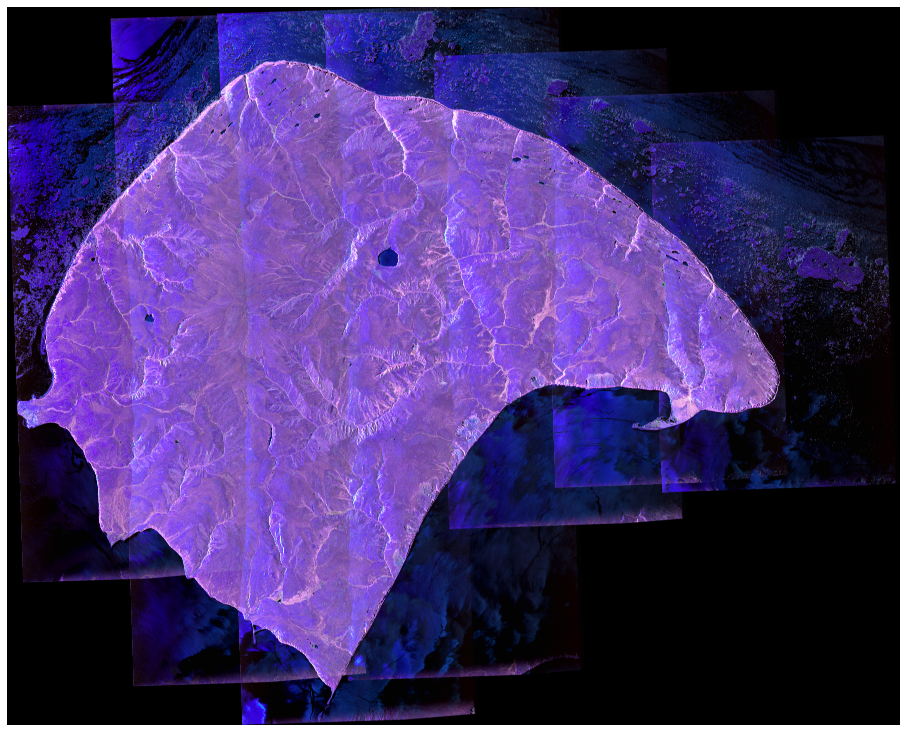

In [11]:
merged = merge.merge_arrays(pauli_18_S, nodata=np.nan, method="max")
pauli_rgb_18_S = create_pauli(merged)


fig, ax = plt.subplots(1, 1)


ax.imshow(pauli_rgb_18_S,  origin='upper',)
ax.axis('off')
fig.savefig(fig_save.joinpath("./PNG/maps/", "pauli_rgb_18_S" +".png"))

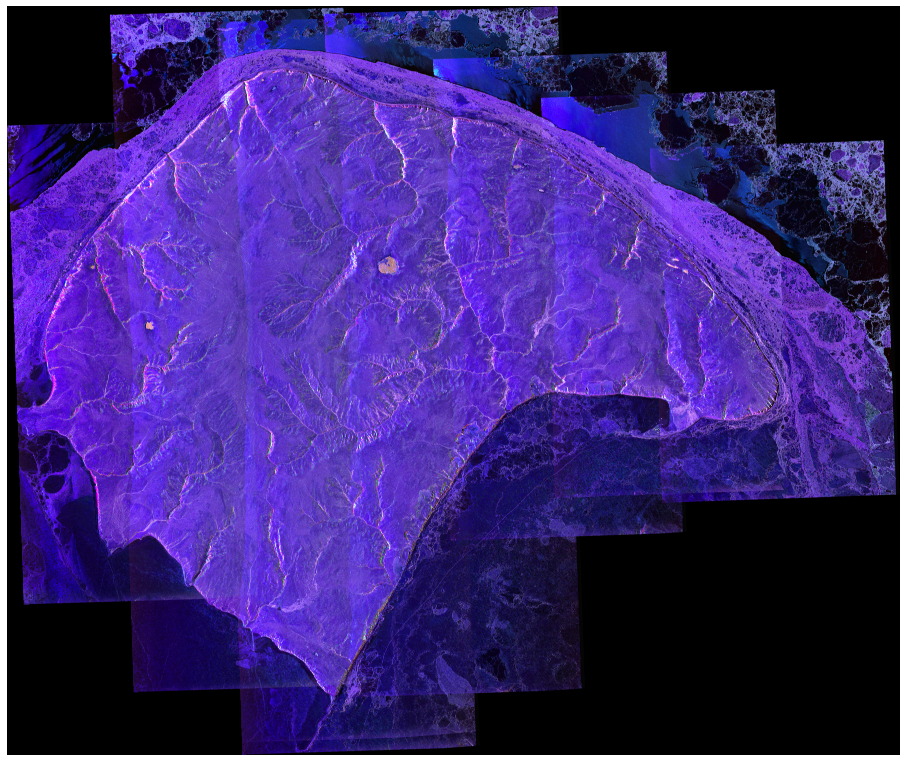

In [12]:
merged = merge.merge_arrays(pauli_19_S, nodata=np.nan, method="max")
pauli_rgb_19_S = create_pauli(merged)


fig, ax = plt.subplots(1, 1)


ax.imshow(pauli_rgb_19_S,  origin='upper',)
ax.axis('off')
fig.savefig(fig_save.joinpath("./PNG/maps/", "pauli_rgb_19_S" +".png"))

In [149]:
rgb/255

masked_array(
  data=[[[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        ...,

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]]],
  mask=[[[ True,  True,  True],
         [ True,

In [125]:
rgba = create_pauli(merged)

In [143]:
rgba
np.ma.set_fill_value(rgba, np.nan)

TypeError: Cannot convert fill_value nan to dtype uint8

In [135]:
rgba.any(axis=2)

masked_array(
  data=[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],
  mask=False,
  fill_value=True)

In [140]:
rgba.mask = True

In [141]:
rgba

masked_array(
  data=[[[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
         ...,
         [--, --, --, --],
         [--, --, --, --],
         [--, --, --, --]],

        [[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
         ...,
         [--, --, --, --],
         [--, --, --, --],
         [--, --, --, --]],

        [[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
         ...,
         [--, --, --, --],
         [--, --, --, --],
         [--, --, --, --]],

        ...,

        [[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
         ...,
         [--, --, --, --],
         [--, --, --, --],
         [--, --, --, --]],

        [[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
         ...,
         [--, --, --, --],
         [--, --, --, --],
         [--, --, --, --]],

        [[--, --, --, --],
         [--, --, --, --],
         [--, --, --, --],
 

In [133]:
np.ma.masked_where(((rgba[:,:,0] == 0 )or (rgba[:,:,1] == 0) or (rgba[:,:,2] == 0)), rgba)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

(-0.5, 18760.5, 14494.5, -0.5)

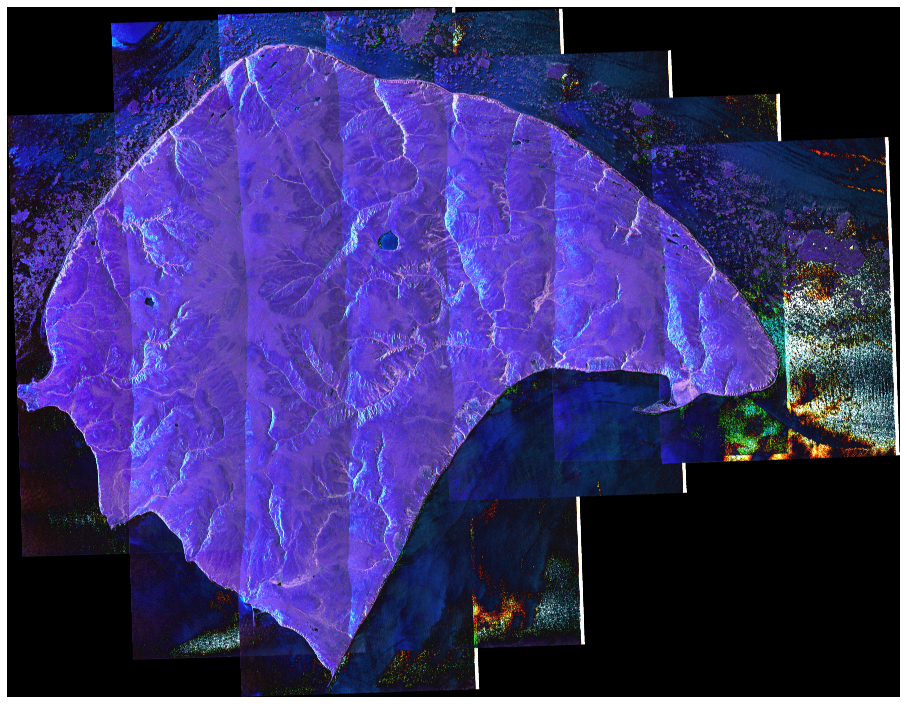

In [150]:


plt.imshow(rgb/255,  origin='upper',)
plt.axis('off')


(-0.5, 18760.5, 14494.5, -0.5)

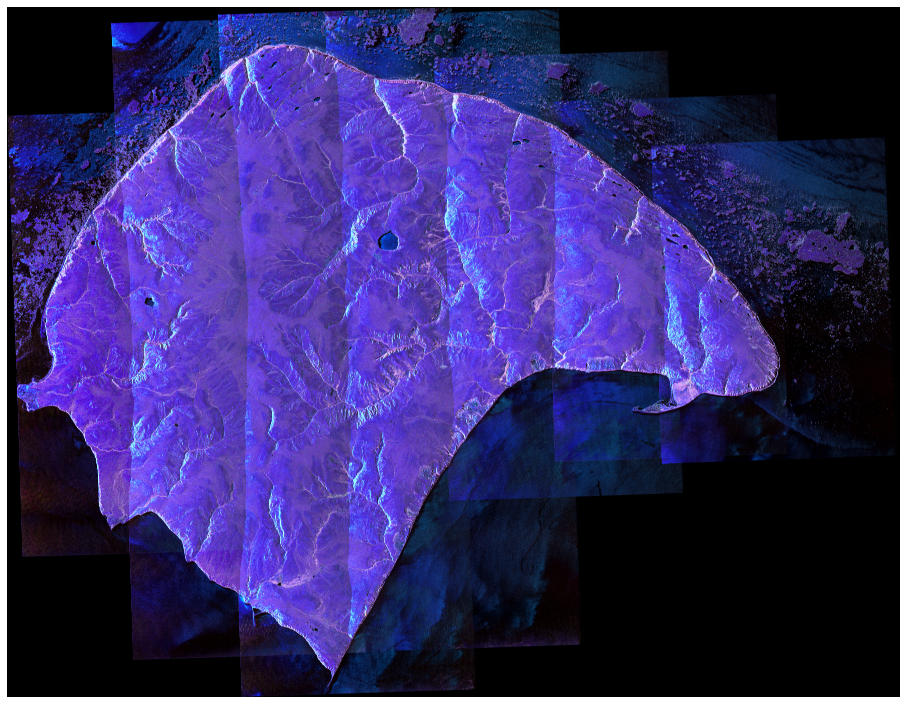

In [156]:
fig, ax = plt.subplots(1, 1)


ax.imshow(create_pauli(merged),  origin='upper',)
ax.axis('off')

In [ ]:
rgb = np.ma.masked_where(k_vec == np.nan, rgb)

(-0.5, 18760.5, 14494.5, -0.5)

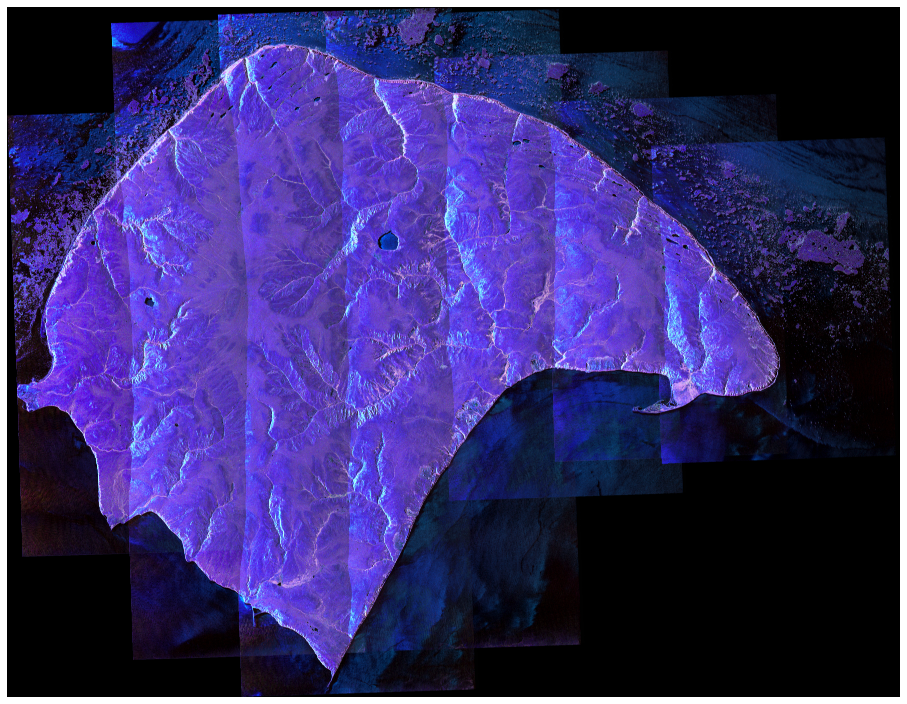

In [121]:
plt.imshow(rgb,  origin='upper',)
plt.axis('off')

(-0.5, 18760.5, 14494.5, -0.5)

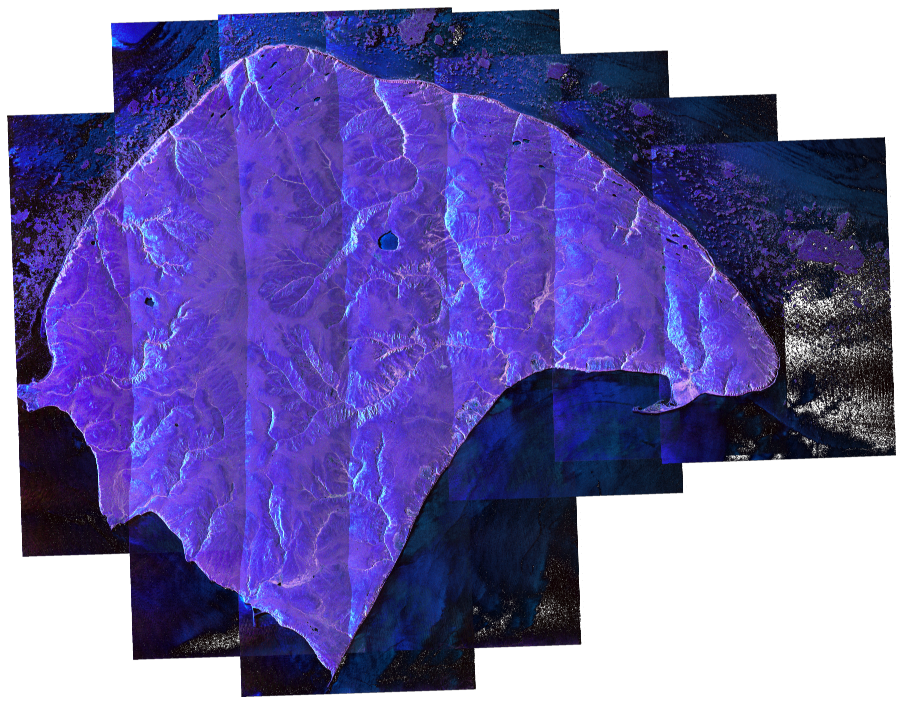

In [120]:
alpha = ~np.all(rgb == 0, axis=2) * 255
# alpha = (k_vec == np.nan)
rgba = np.dstack((rgb, alpha)).astype(np.uint8)

plt.imshow(rgba,  origin='upper',)
plt.axis('off')


In [118]:
fig.savefig(fig_save.joinpath("./PNG/maps/", "pauli_map_18_L" +".png"), 
            facecolor='w', transparent=False)


In [ ]:
fig.savefig("./processed/results/{}_plot_coh_im.png".format(suptitle))

fig.savefig(fig_save.joinpath("./PNG/maps/", "pauli_map_18_L" +".png"))

In [99]:
pauli_vector = np.moveaxis([merged.data[0, :, :], merged.data[1, :, :], merged.data[2, :, :]], 0, -1)

k_vec = np.abs(pauli_vector)
# k_vec = np.ma.masked_where(k_vec == np.nan, k_vec)

k_sca = k_vec ** 0.7
vmin=2
vmax=98
im_perc = np.nanpercentile(k_sca, [vmin, vmax])
k_sca = np.ma.masked_invalid(k_sca)

"""
k_1 = plot.permasar.bytescale(k_sca[:, :, 0], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
k_2 = plot.permasar.bytescale(k_sca[:, :, 1], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
k_3 = plot.permasar.bytescale(k_sca[:, :, 2], cmin=np.nanmin(k_sca), cmax=np.nanmax(k_sca))
"""
k_1 = plot.permasar.bytescale(k_sca[:, :, 0], cmin=im_perc[0], cmax=im_perc[1])
k_2 = plot.permasar.bytescale(k_sca[:, :, 1], cmin=im_perc[0], cmax=im_perc[1])
k_3 = plot.permasar.bytescale(k_sca[:, :, 2], cmin=im_perc[0], cmax=im_perc[1])

rgb = plot.permasar.np.stack((k_2, k_1, k_3), axis=2)

In [100]:
fig_save = Path("./../figures/")

array([ 4.05627346, 48.09424973])

In [102]:
rgb.min()

0

(-0.5, 18760.5, 14494.5, -0.5)

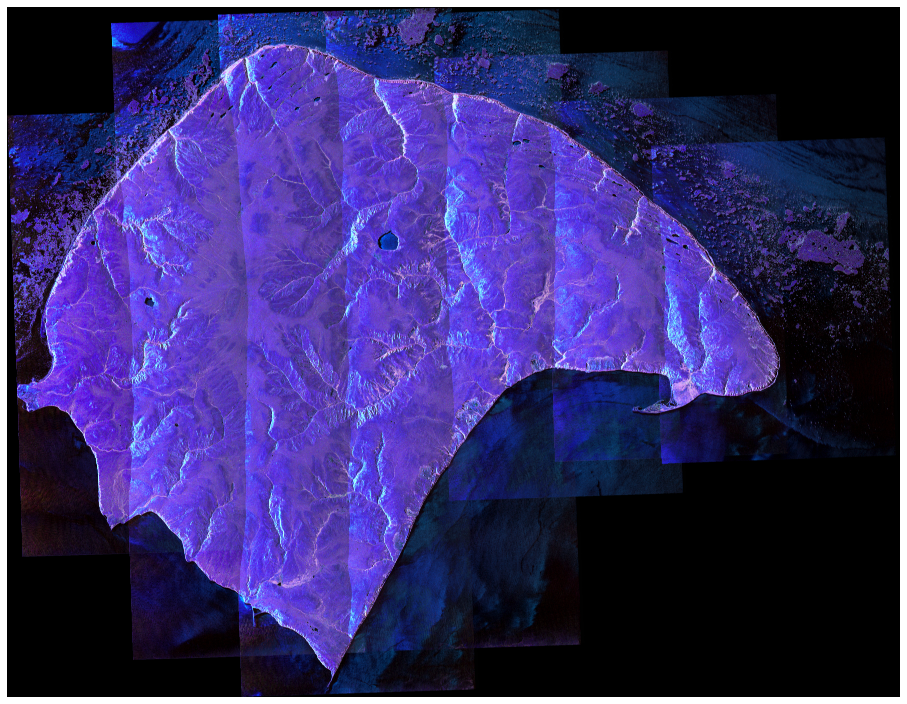

In [108]:
rgb = np.ma.masked_where(k_vec == np.nan, rgb)
current_cmap = plt.cm.get_cmap()
current_cmap.set_bad(color='white')

plt.imshow(rgb,  origin='upper',)
plt.axis('off')


(-0.5, 18760.5, 14494.5, -0.5)

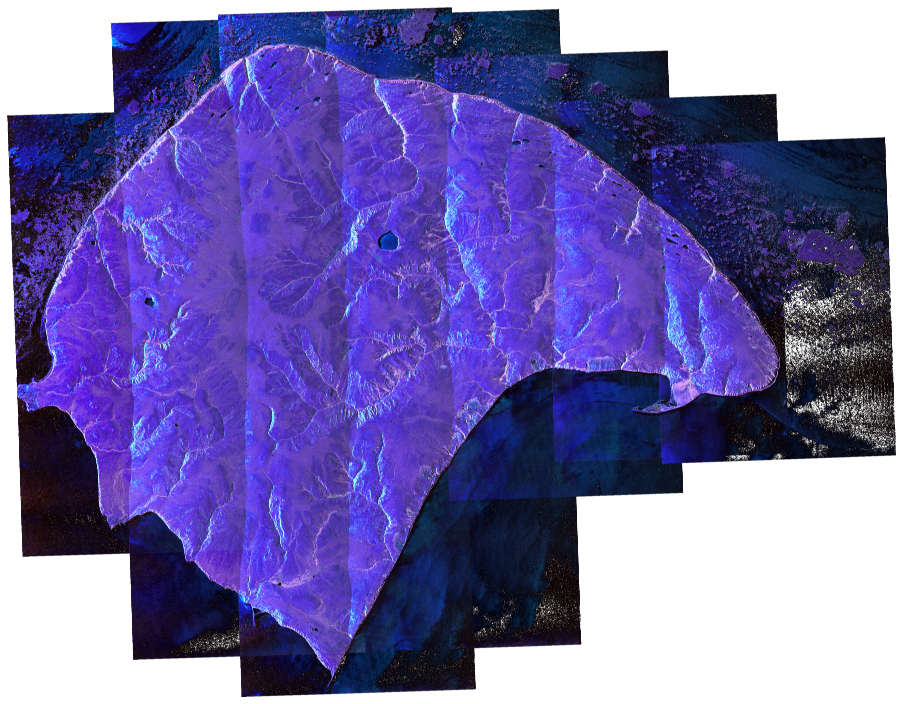

In [110]:
alpha = ~np.all(rgb == 255, axis=2) * 255
# alpha = (k_vec == np.nan)
rgba = np.dstack((rgb, alpha)).astype(np.uint8)

plt.imshow(rgba,  origin='upper',)
plt.axis('off')


In [106]:
rgb

masked_array(
  data=[[[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        ...,

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]],

        [[--, --, --],
         [--, --, --],
         [--, --, --],
         ...,
         [--, --, --],
         [--, --, --],
         [--, --, --]]],
  mask=[[[ True,  True,  True],
         [ True,

In [22]:
merged

<xarray.DataArray (band: 4, y: 14495, x: 18761)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)
Coordinates:
  * x            (x) float64 5.675e+05 5.675e+05 ... 5.863e+05 5.863e+05
  * y            (y) float64 7.728e+06 7.728e+06 ... 7.713e+06 7.713e+06
  * band         (band) int64 1 2 3 4
    spatial_ref  int64 0
Attributes:
    scale_factor:         1.0
    add_offset:           0.0
    bands:                4
    byte_order:           0
    data_type:            4
    description:          Geocoded data /fsar_raid/18PRMASR/FL03/PS02/T01L/GT...
    file_type:            ENVI Standard
    georeferenced:        UTM
    header_offset:        1000
    interleave:           BIP
    lines:                9420
    max_easting:          572893.0381734846
    max_northing:         7725448.6809147662
    min_easting:          567539.0381734846
    min_northing:         7716029.6809147662
    pixel_spacing_east:   1.0000000000
    pixel_spacing_north:  1.0000000000
    projection_zone:      7
    samples:              5355
    sensor_type:          SAR
    spheroid_name:        WGS-84
    wavelength:           [0.22620758]
    grid_mapping:         spatial_ref
    _FillValue:           nan

In [55]:
np.nanmean(merged.data[0, :, :]), np.nanmean(merged.data[1, :, :]), np.nanmean(merged.data[2, :, :]), np.nanmean(merged.data[3, :, :]), 

(32.160744, 41.54367, 84.14301, 254.19606)

In [69]:
# pauli_vector = np.moveaxis([merged.data[0, :, :], (merged.data[1, :, :]+merged.data[2, :, :])/2, merged.data[3, :, :]], 0, -1)
pauli_vector = np.moveaxis([merged.data[0, :, :], merged.data[1, :, :], merged.data[2, :, :]], 0, -1)

pauli_vec_rgb = plot.permasar.stack_rgb(
    r=pauli_vector[:, :, 1],
    g=pauli_vector[:, :, 0],
    b=pauli_vector[:, :, 2],
)
print(
    "Image min:",
    np.nanmin(pauli_vec_rgb),
    "Image mean:",
    np.nanmean(pauli_vec_rgb),
    ",Image max:",
    np.nanmax(pauli_vec_rgb),
)
# pauli_vec_rgb_norm = np.interp(decibel_to_linear(np.abs(pauli_vec_rgb)), (decibel_to_linear(np.amin(np.abs(pauli_vec_rgb))), np.max(decibel_to_linear(np.abs(pauli_vec_rgb)))), (0, 1))
k_vec = np.abs(pauli_vector)
k_sca = k_vec ** 0.7
"""
vmin=2
vmax=98
im_perc = np.percentile(np.abs(k_sca), [vmin, vmax])
"""
k_1 = plot.permasar.bytescale(k_sca[:, :, 0], cmin=k_sca.min(), cmax=k_sca.mean())
k_2 = plot.permasar.bytescale(k_sca[:, :, 1], cmin=k_sca.min(), cmax=k_sca.mean())
k_3 = plot.permasar.bytescale(k_sca[:, :, 2], cmin=k_sca.min(), cmax=k_sca.mean())
rgb = np.stack((k_2, k_3, k_1), axis=2)


Image min: -54.185402 Image mean: 16.618055 ,Image max: 24.885098


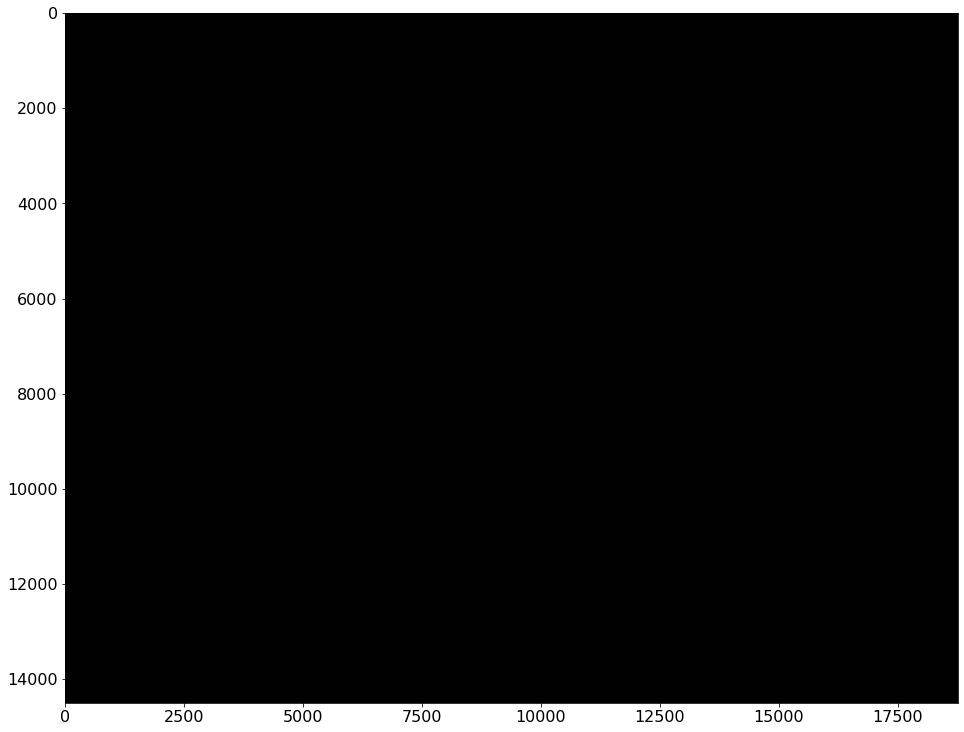

In [57]:
plt.imshow(
    rgb,  origin='upper',)

In [46]:
def mag2db(x):
    return 10*np.log10(x)

def db2mag(mag):
    return 10**(0.1*mag)

In [70]:
pauli_vec_rgb_mag = db2mag(pauli_vec_rgb)

In [71]:
np.nanmean(pauli_vec_rgb_mag)

71.6919

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


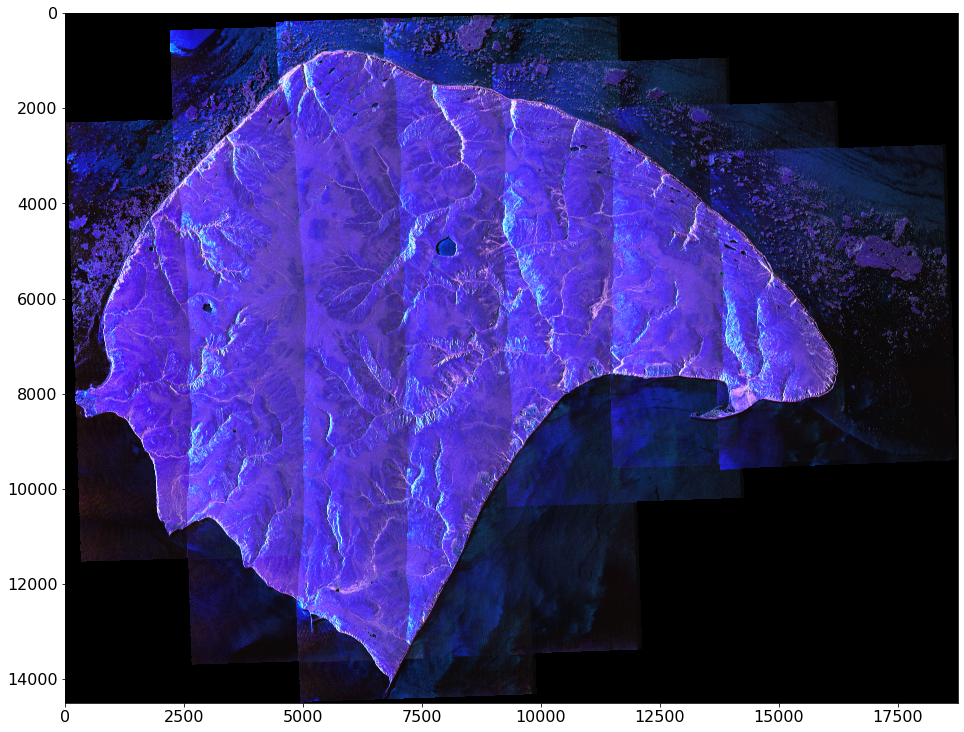

In [72]:
plt.imshow(pauli_vec_rgb_mag/(np.nanmax(pauli_vec_rgb_mag)*0.7),  origin='upper',)

(-0.5, 18760.5, 14494.5, -0.5)

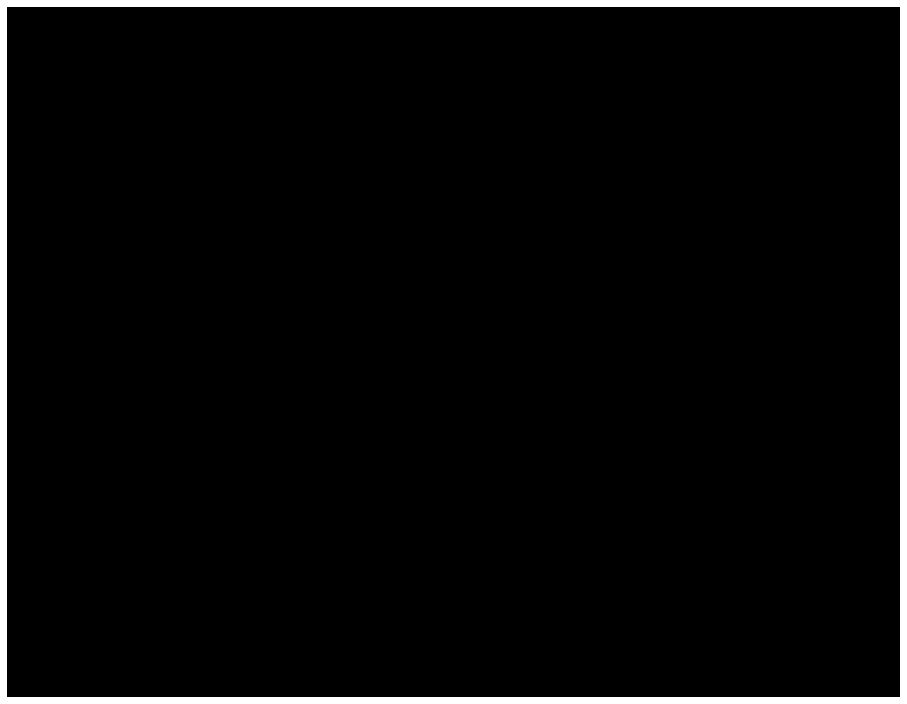

In [74]:
pauli_vec_rgb_mag = db2mag(pauli_vec_rgb)** 0.7
plt.imshow(pauli_vec_rgb_mag/(np.mean(pauli_vec_rgb_mag)),  origin='upper',)
plt.axis('off')


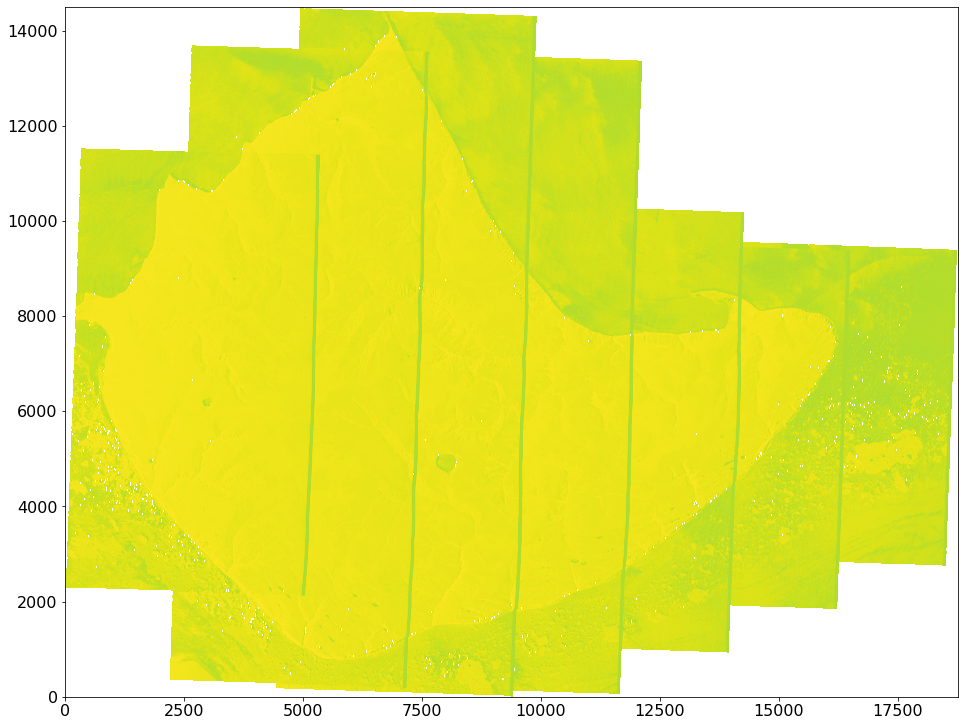

In [40]:
from matplotlib.colors import LogNorm

plt.imshow(pauli_vec_rgb[:, :, 0], norm=LogNorm(),  origin='upper',)

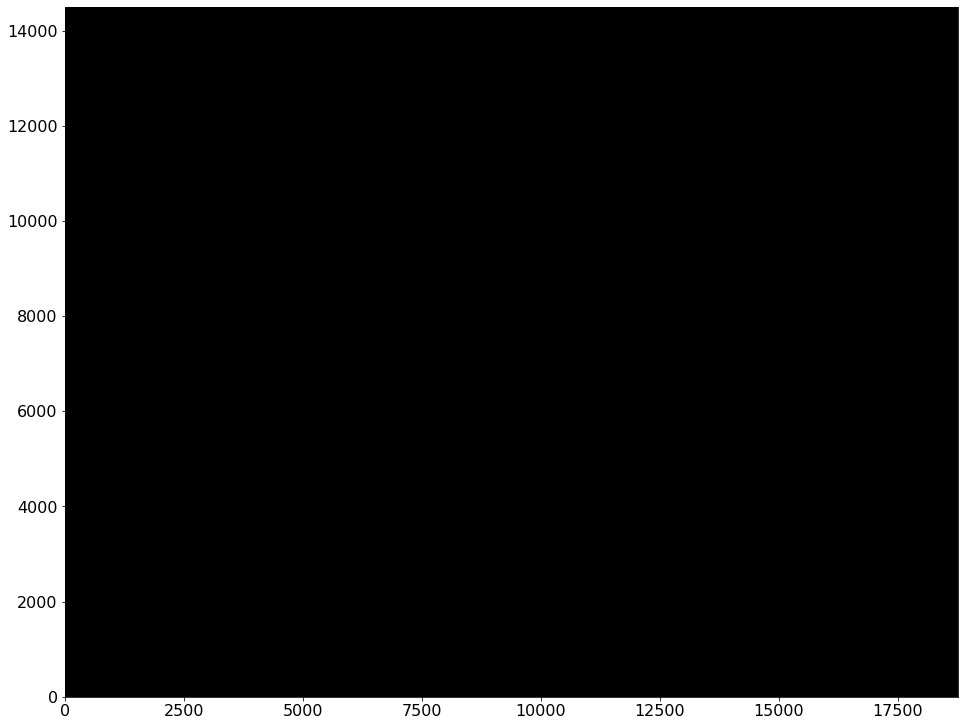

In [37]:
ax_ang = plt.imshow(
    rgb,  # vmin=pauli_vec_rgb.min(), vmax=pauli_vec_rgb.max(),
    # aspect=aspect,
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 18760.5, 14494.5, -0.5)

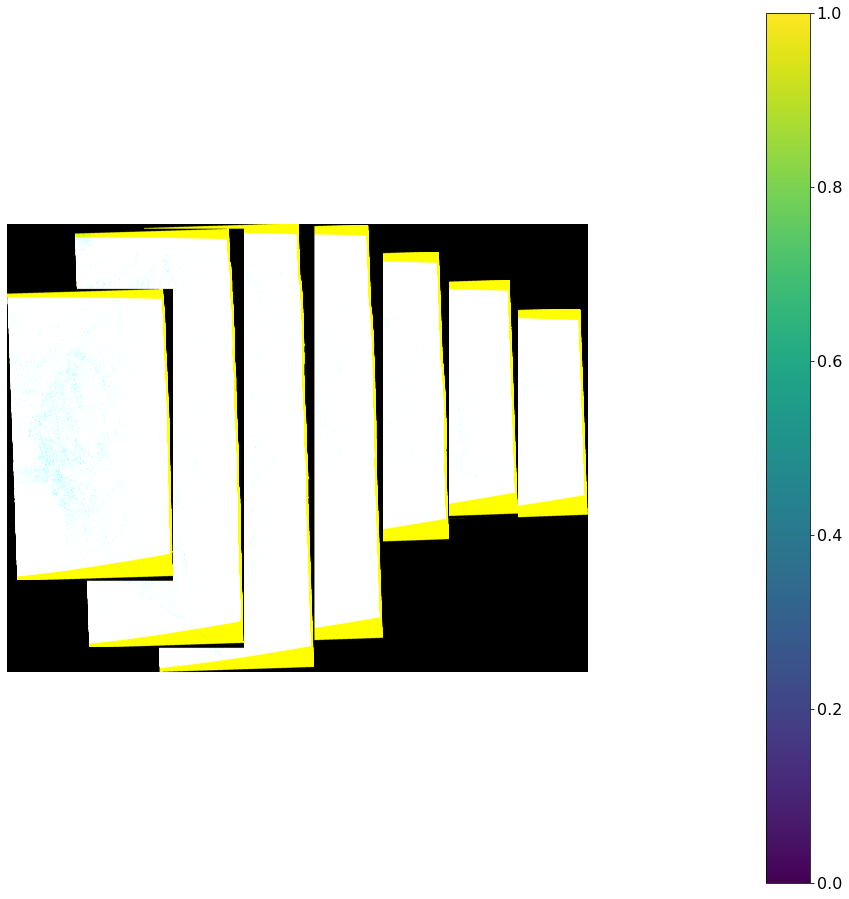

In [26]:
plt.imshow(np.moveaxis([merged.data[0, :, :], (merged.data[1, :, :]+merged.data[2, :, :])/2, merged.data[3, :, :]], 0, -1), origin='upper', )
plt.colorbar(orientation="vertical", pad=0.2)
plt.axis('off')

In [ ]:
import rioxarray
from rioxarray import merge
from rasterio.plot import show

process_path = Path('./processed/')
prj = Path('./../data/01_projects/')

files = sorted(list( process_path.glob('./polarimetric/19*[!1010]_L_entropy.tif')))

    prj_data_paths["18"]["pauli_geo"]  = sorted(list( prj_path.glob('./18PRMASR/**/FL03/**/T*[!X]/**/GTC-IMG/pauli*.rat')))

    prj_data_paths["19"]["pauli_geo"] = sorted(list( prj.glob('./19PRMASR/**/FL10/**/T*[!X]/**/GTC-IMG/pauli*.rat')))

    
elements = []

dst_crs = 'EPSG:4326'


for val in files:
    print(val)
    rds = rioxarray.open_rasterio(val)
    #rds = xr.open_rasterio(val).squeeze()
    #rds = rio.open(val)
    #if rds.rio.crs != dst_crs:
    #    rds = rds.rio.reproject(dst_crs)
    elements.append(rds)

In [26]:
import rioxarray
from rioxarray import merge
from rasterio.plot import show

process_path = Path('./processed/')

files = sorted(list( process_path.glob('./polarimetric/19*[!1010]_L_entropy.tif')))

elements = []

dst_crs = 'EPSG:4326'


for val in files:
    print(val)
    rds = rioxarray.open_rasterio(val)
    #rds = xr.open_rasterio(val).squeeze()
    #rds = rio.open(val)
    #if rds.rio.crs != dst_crs:
    #    rds = rds.rio.reproject(dst_crs)
    elements.append(rds)



processed/polarimetric/19prmasr1002_L_entropy.tif
processed/polarimetric/19prmasr1003_L_entropy.tif
processed/polarimetric/19prmasr1004_L_entropy.tif
processed/polarimetric/19prmasr1006_L_entropy.tif
processed/polarimetric/19prmasr1007_L_entropy.tif
processed/polarimetric/19prmasr1008_L_entropy.tif
processed/polarimetric/19prmasr1009_L_entropy.tif


In [27]:
merged = merge.merge_arrays(elements, nodata=np.nan)  # , method="first")


(-0.5, 18749.5, 14870.5, -0.5)

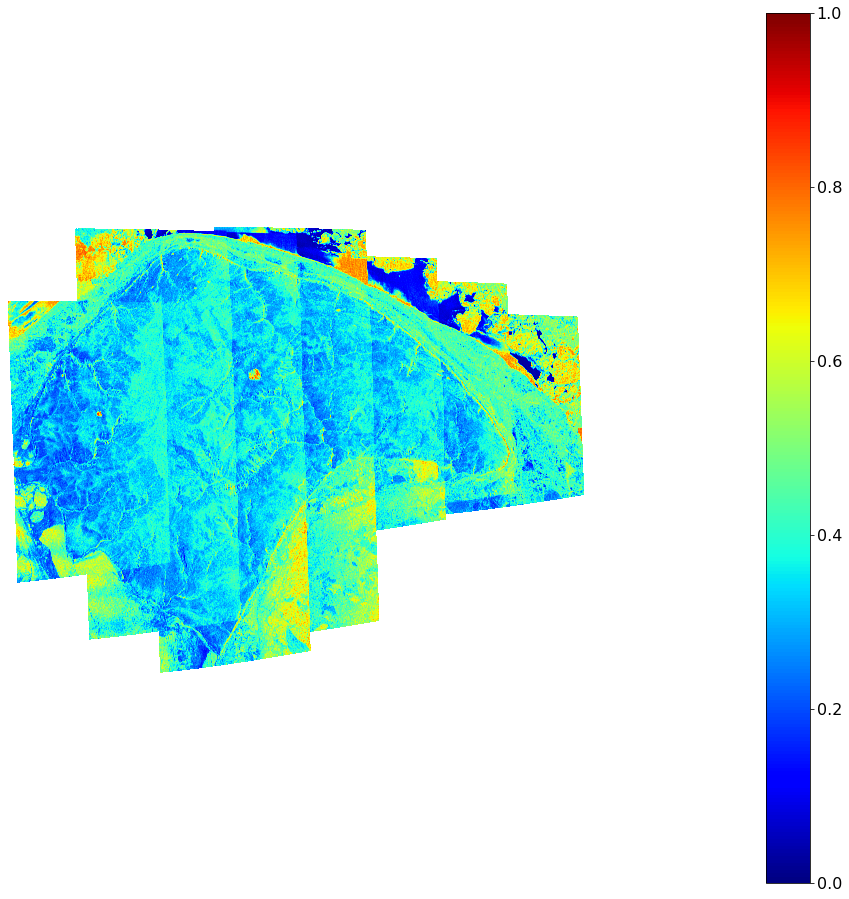

In [28]:
plt.imshow(merged.data[0, :, :], vmin=0, vmax=1, cmap="jet", origin='upper', )
plt.colorbar(orientation="vertical", pad=0.2)
plt.axis('off')


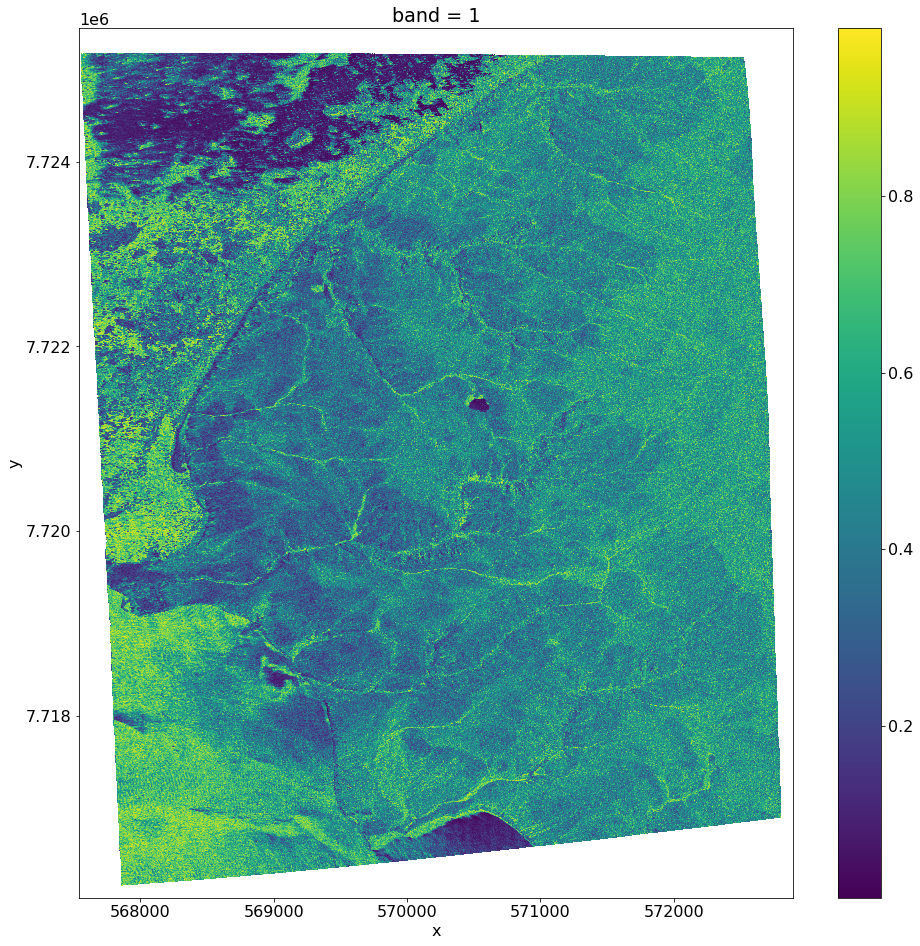

In [10]:
src = xr.open_rasterio(files[0])

src.plot()

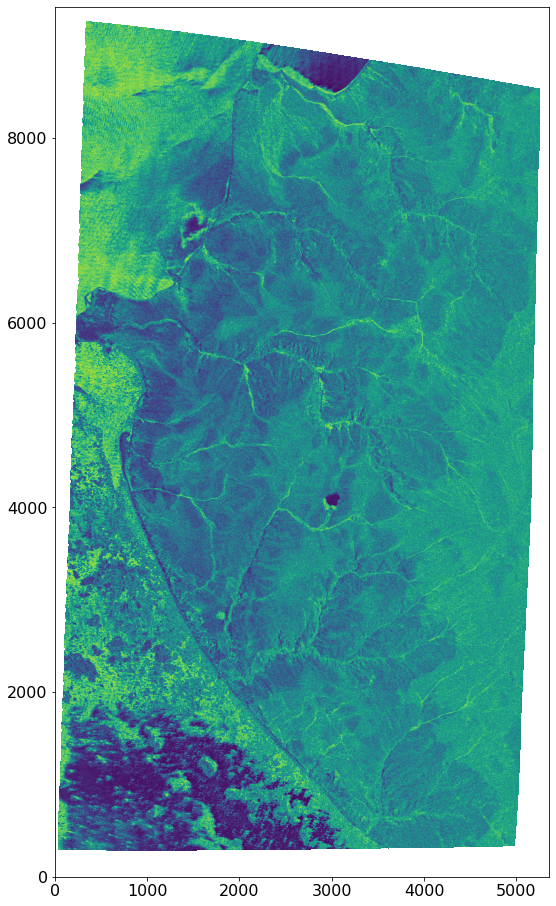

<AxesSubplot:>

In [12]:
src = rio.open(files[0])

rio.plot.show(src.read(), with_bounds=True, ) # transform=src.transform)

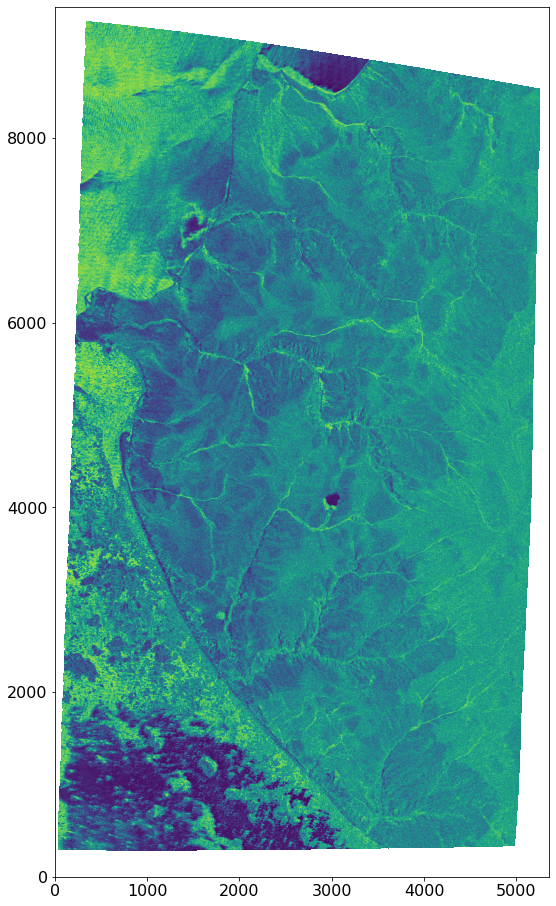

<AxesSubplot:>

In [73]:
from rasterio.plot import show
show(elements[0])

In [ ]:
fig, (axrgb, axhist) = pyplot.subplots(1, 2, figsize=(14,7))
show(src, ax=axrgb)

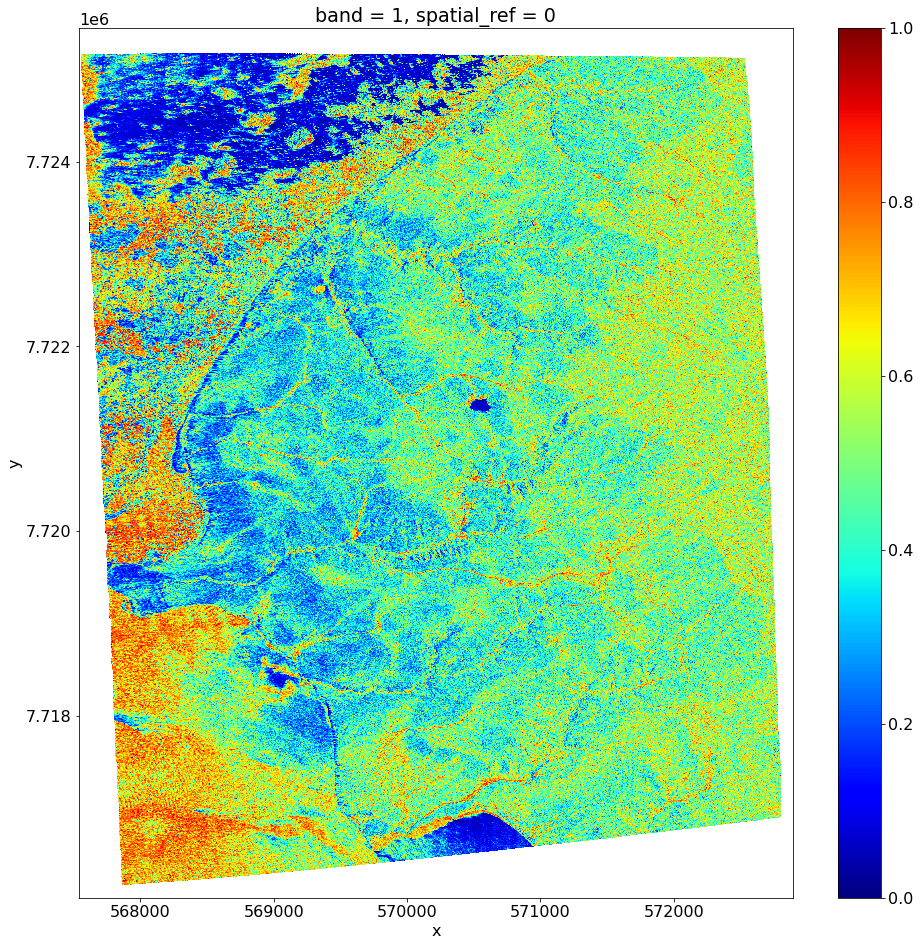

In [71]:
elements[0].plot.imshow(cmap='jet', vmin=0, vmax=1, alpha=1, int)

In [59]:
merged = merge.merge_arrays(elements, nodata=np.nan,  method="first") #


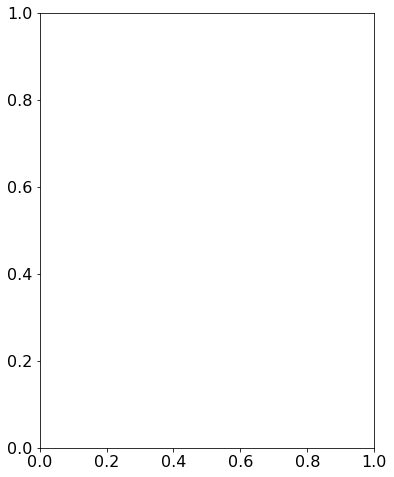

In [70]:
figsize = [6, 8]     # figure size, inches

nrows = 1
ncols = 1
# create figure (fig), and array of axes (ax)
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)

AttributeError: 'tuple' object has no attribute 'canvas'

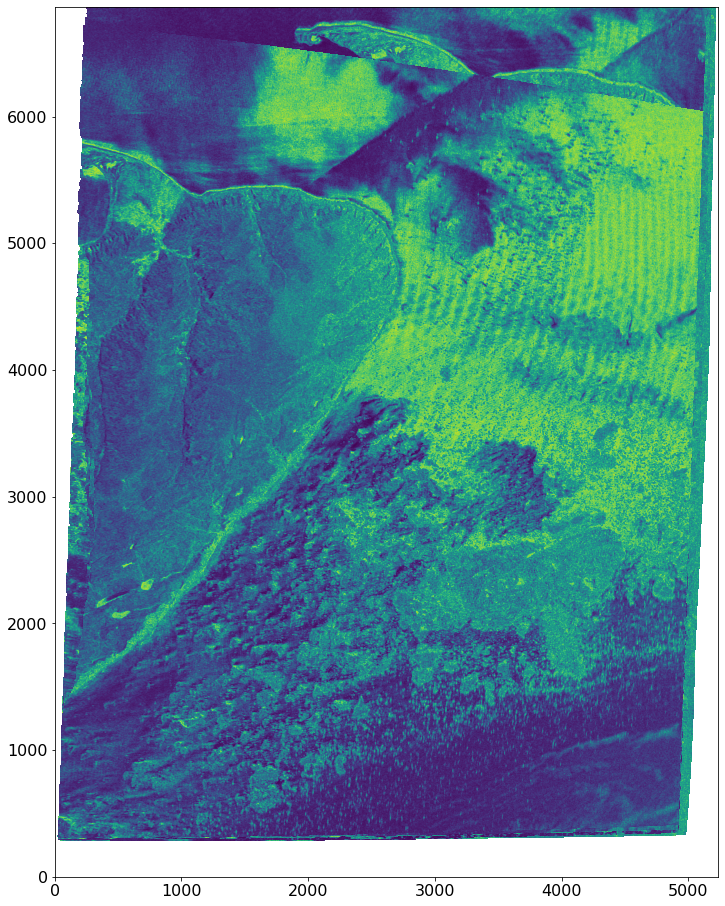

In [69]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

fig = plt.subplots()


# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
for element in elements:
    im = plt.imshow(element, animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save('./videos/dynamic_images.mp4')

plt.show()

NameError: name 'merged' is not defined

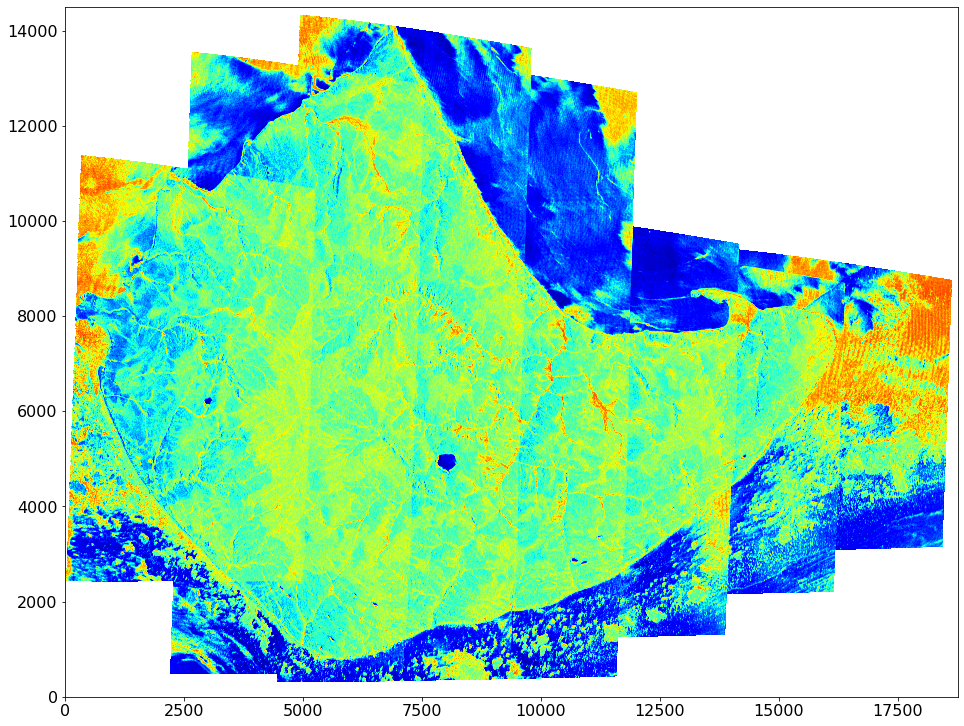

<AxesSubplot:>

In [60]:
show(merged, vmin=0, vmax=1, cmap="jet")

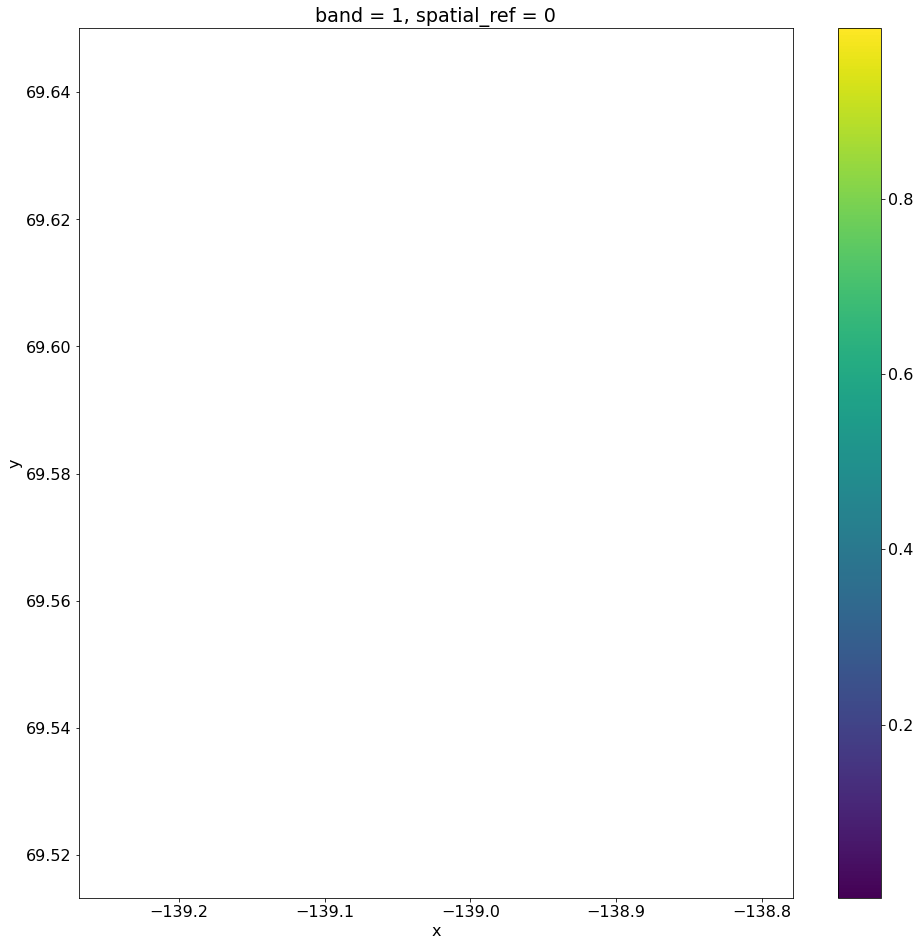

In [46]:
merged.plot()

In [ ]:
In [1]: import rasterio

In [2]: from rasterio.merge import merge

In [3]: from rasterio.plot import show

In [4]: import glob

In [5]: import os

In [5]:
shape =list( process.glob('./**/*.shp'))
shape_sorted = sorted((shape))

for i in range(len(shape_sorted)):
    print(i, "\t", shape_sorted[i].name)


0 	 Ecological_classification_Herschel_Island.shp
1 	 gis_osm_landuse_a_free.shp
2 	 gis_osm_water_a_free.shp


In [6]:
ecological_classes = gpd.read_file(shape_sorted[0])
land_mask = gpd.read_file(shape_sorted[1])
lakes_mask = gpd.read_file(shape_sorted[2])

<AxesSubplot:>

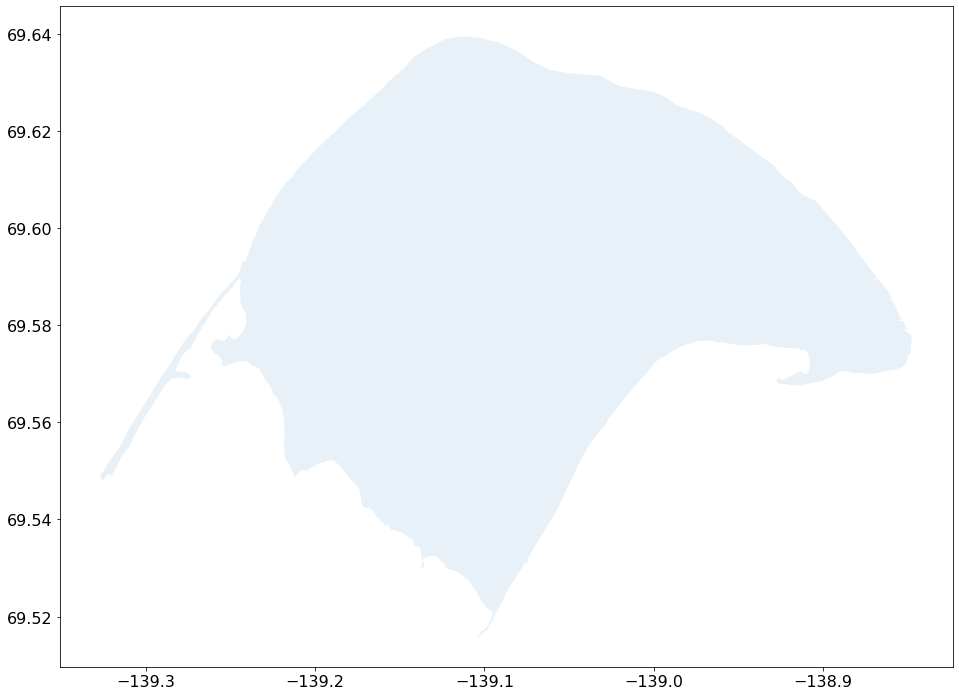

In [10]:
fig, ax = plt.subplots(1, 1)

land_mask.plot(ax=ax, color='C0', alpha=0.1)

In [20]:
land_mask.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

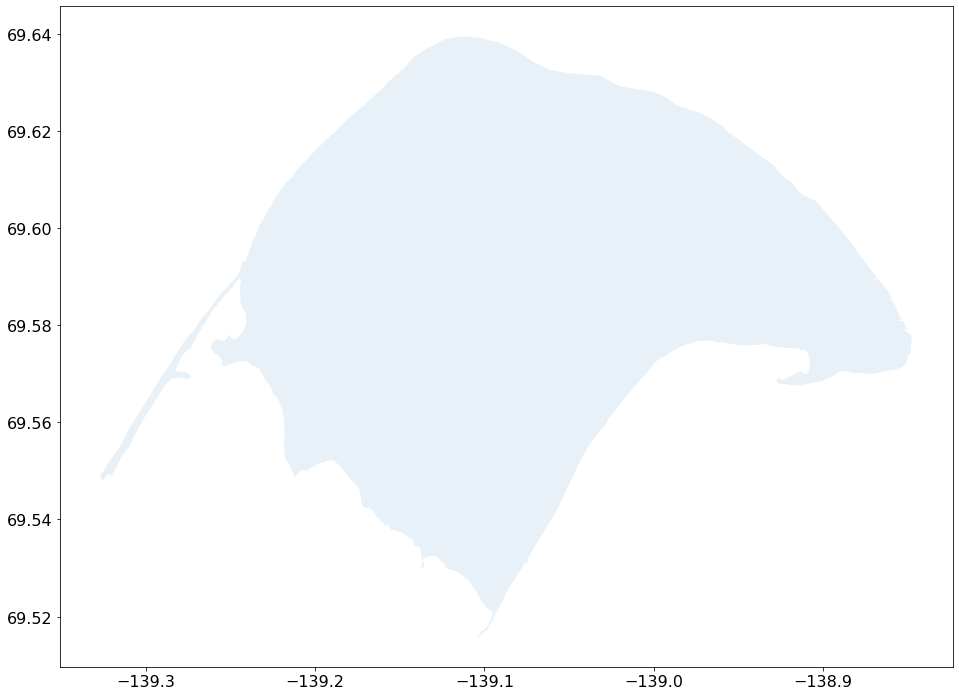

In [26]:
import warnings
warnings.filterwarnings("ignore")

fig, ax = plt.subplots(1, 1)

land_mask.plot(ax=ax, alpha=0.1)

raster_image = xr.open_rasterio(prj_paths[year_key][acq_key]["pol"]["entropy"], 'r')

# raster_image.plot(ax=ax, vmin=0, vmax=1, cmap="jet")

In [28]:
dst_crs = 'EPSG:4326'

raster_wgs84 = raster_image.rio.reproject(dst_crs=dst_crs)


ValueError: A 3-dimensional array was passed to imshow(), but there is no dimension that could be color.  At least one dimension must be of size 3 (RGB) or 4 (RGBA), and not given as x or y.

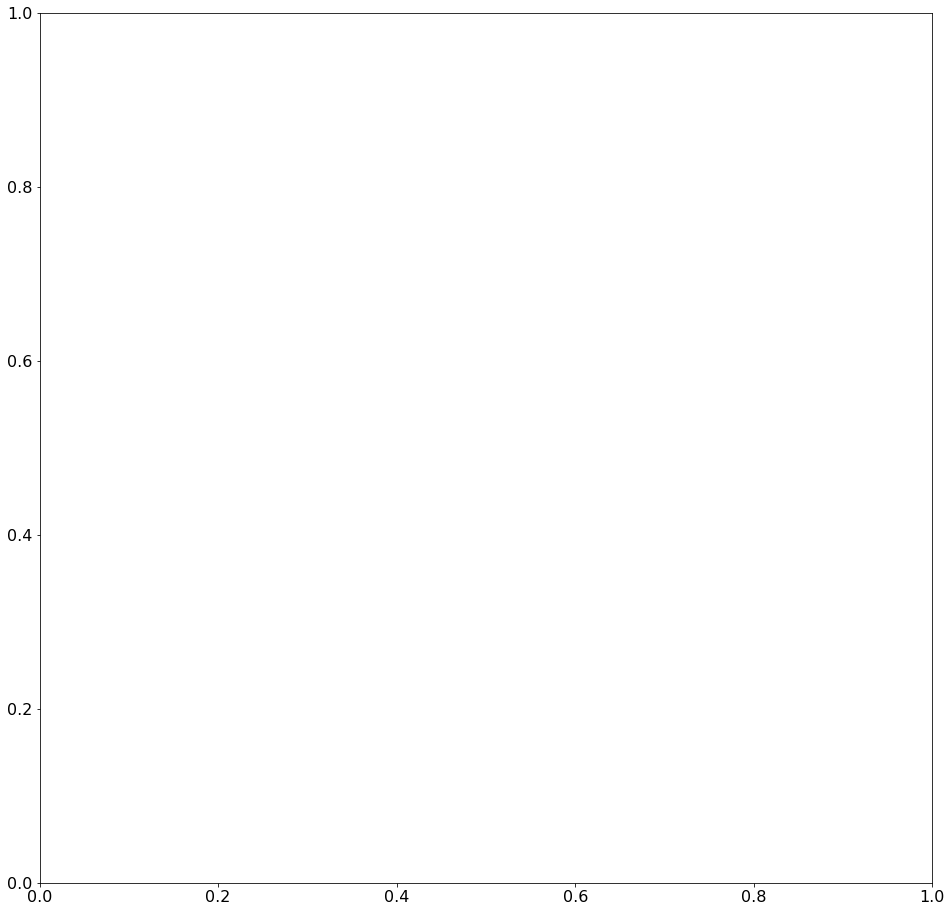

In [36]:
fig, ax = plt.subplots(1, 1)

raster_wgs84.coords['data_1'] = (('y', 'x'), raster_wgs84.data[0, :, :])
raster_wgs84.plot.imshow(,vmin=0, vmax=1, cmap="jet")

land_mask.plot(ax=ax)

In [ ]:
dst_crs = 'EPSG:4326'


fig, ax = plt.subplots(1, 1)

land_mask.plot(ax=ax, alpha=0.1)

raster_image = xr.open_rasterio(prj_paths[year_key][acq_key]["pol"]["entropy"], 'r')
# raster_wgs84 = raster_image.rio.reproject(dst_crs=dst_crs)


In [25]:
rasterio.warp.reproject(src)

TypeError: cannot unpack non-iterable DatasetReader object

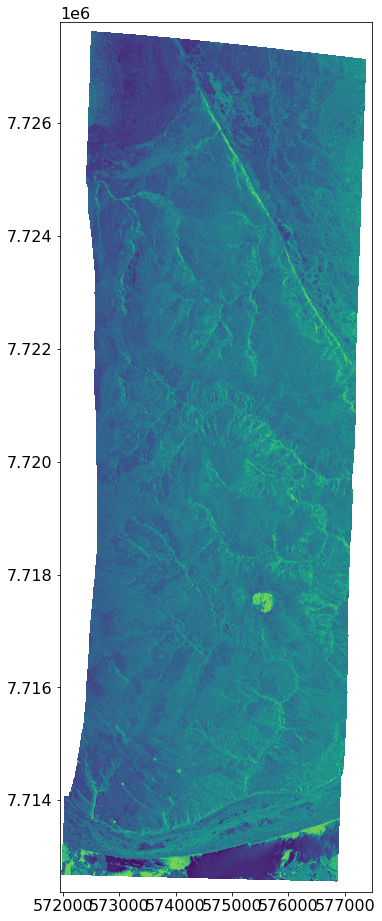

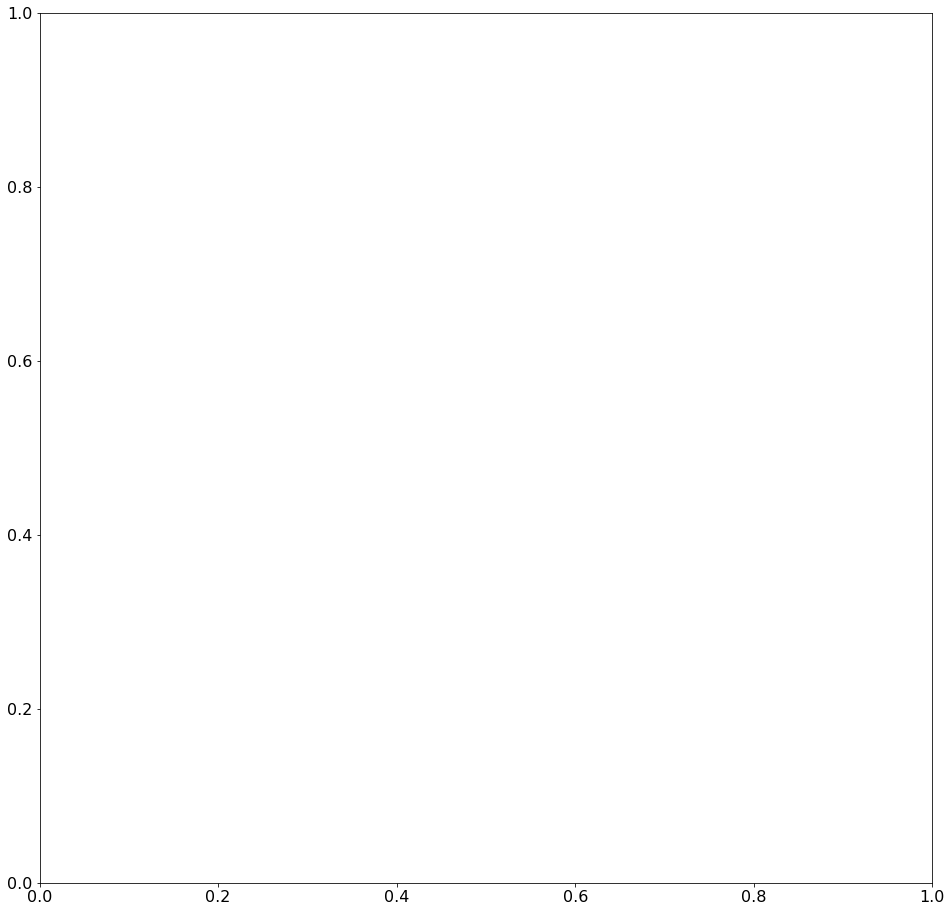

In [24]:
import fiona
import rasterio
import rasterio.plot
import matplotlib as mpl
from descartes import PolygonPatch

fig, ax = plt.subplots(1, 1)


src = rasterio.open(prj_paths[year_key][acq_key]["pol"]["entropy"])

with fiona.open(shape_sorted[1], "r") as shapefile:
    features = [feature["geometry"] for feature in shapefile]

rasterio.plot.show((src, 1))
ax = mpl.pyplot.gca()

patches = [PolygonPatch(feature) for feature in features]
ax.add_collection(mpl.collections.PatchCollection(patches))

In [ ]:
src = entopy_ds
shapes = ecological_classes
shapes = shapes.to_crs(src.crs)
print(src.crs, shapes.crs)

fig, ax = plt.subplots(1, 1)



shapes.plot(column='Legend', ax=ax, legend=True)
src.plot(ax=ax)

In [17]:
fig, ax = plt.subplots(1, 1)

land_mask.plot(ax=ax, color='C0', alpha=0.1)

for year_key in list(prj_paths.keys()):
    print(year_key)
    for acq_key in list(prj_paths[year_key].keys()):
        print(acq_key)
        with xr.open_rasterio(prj_paths[year_key][acq_key]["pol"]["entropy"], 'r') as raster_image:
            raster_image.plot(ax=ax, vmin=0, vmax=1, cmap="jet")
        
        

18
18prmasr0302_L
18prmasr0302_S
18prmasr0303_L
18prmasr0303_S
18prmasr0304_L
18prmasr0304_S
18prmasr0305_L
18prmasr0305_S
18prmasr0306_L
18prmasr0306_S
18prmasr0307_L
18prmasr0307_S
18prmasr0308_L
18prmasr0308_S
19
19prmasr1002_L
19prmasr1002_S
19prmasr1003_L
19prmasr1003_S
19prmasr1004_L
19prmasr1004_S
19prmasr1006_L
19prmasr1006_S
19prmasr1007_L
19prmasr1007_S
19prmasr1008_L
19prmasr1008_S
19prmasr1009_L
19prmasr1009_S
19prmasr1010_L
19prmasr1010_S


In [11]:
for data_18, data_19 in zip(list(prj_paths["18"].keys()), list(prj_paths["18"].keys()) ):
    print(data_18, data_19 )
    for pol_path in list(prj_paths["18"][data_18]):
        
        xr.open_rasterio(prj_paths["18"][title_key_18]["pol"][pol_key], 'r') as raster_18,
    

18prmasr0302_L 18prmasr0302_L
18prmasr0302_S 18prmasr0302_S
18prmasr0303_L 18prmasr0303_L
18prmasr0303_S 18prmasr0303_S
18prmasr0304_L 18prmasr0304_L
18prmasr0304_S 18prmasr0304_S
18prmasr0305_L 18prmasr0305_L
18prmasr0305_S 18prmasr0305_S
18prmasr0306_L 18prmasr0306_L
18prmasr0306_S 18prmasr0306_S
18prmasr0307_L 18prmasr0307_L
18prmasr0307_S 18prmasr0307_S
18prmasr0308_L 18prmasr0308_L
18prmasr0308_S 18prmasr0308_S


In [12]:
prj_paths["18"][data_18]

{'geo': {'incidence': PosixPath('01_projects/18PRMASR/FL03/PS08/T01S/GTC/GTC-IMG/incidencegeo_18prmasr0308_S_t01S.rat'),
  'mask': PosixPath('01_projects/18PRMASR/FL03/PS08/T01S/GTC/GTC-IMG/maskgeo_18prmasr0308_S_t01S.rat'),
  'offnadir': PosixPath('01_projects/18PRMASR/FL03/PS08/T01S/GTC/GTC-IMG/offnadirgeo_18prmasr0308_S_t01S.rat')},
 'pol': {'entropy': PosixPath('processed/polarimetric/18prmasr0308_S_entropy.tif'),
  'anisotropy': PosixPath('processed/polarimetric/18prmasr0308_S_anisotropy.tif'),
  'alpha': PosixPath('processed/polarimetric/18prmasr0308_S_alpha.tif'),
  'p_hhvv': PosixPath('processed/polarimetric/18prmasr0308_S_p_hhvv.tif'),
  'ph_diff_hhvv': PosixPath('processed/polarimetric/18prmasr0308_S_ph_diff_hhvv.tif')}}

In [ ]:
import numpy
import scipy.stats.mstats
import fiona
import rasterio
import rasterio.features
from affine import Affine
from shapely.geometry import shape

import warnings
warnings.filterwarnings("ignore")


# make list
masks = {}
import pandas as pd
dfObj = pd.DataFrame(columns=['UnitName'], dtype=float)
df_dict = {}

def dropna(arr, *args, **kwarg):
    assert isinstance(arr, np.ndarray)
    dropped=pd.DataFrame(arr).dropna(*args, **kwarg).values
    if arr.ndim==1:
        dropped=dropped.flatten()
    return dropped

image_masked = {}
image_masked["18"] = {}
image_masked["19"] = {}
n_shift = 0
for title_key_18, title_key_19 in zip(list(prj_paths["18"].keys())[0+n_shift:4+n_shift], list(prj_paths["19"].keys())[0+n_shift:4+n_shift]):
    image_masked["18"][title_key_18] = {}
    image_masked["19"][title_key_19] = {}

    print(title_key_18)
    for pol_key in list(prj_paths["18"][title_key_18]["pol"]):
        print(pol_key)
        image_masked["18"][title_key_18][pol_key] = {}